In [1]:
import pandas as pd
pd.set_option("display.max_columns", None)

# [Tutorials](https://pycaret.gitbook.io/docs/get-started/tutorials)

## [Binary Classification Tutorial (CLF102) - Level Intermediate](https://nbviewer.org/github/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Intermediate%20-%20CLF102.ipynb)

Created using: PyCaret 2.2

Date Updated: November 20, 2020

### 1.0 Tutorial Objective

Welcome to the Binary Classification Tutorial **(CLF102)** - Level Intermediate. This tutorial assumes that you have completed [Binary Classification Tutorial (CLF101) - Level Beginner](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb). If you haven't used PyCaret before and this is your first tutorial, we strongly recommend you to go back and progress through the beginner tutorial to understand the basics of working in PyCaret.

In this tutorial we will use the `pycaret.classification` module to learn:

- **Normalization**: How to normalize and scale the dataset
- **Transformation**: How to apply transformations that make the data linear and approximately normal
- **Ignore Low Variance**: How to remove features with statistically insignificant variances to make the experiment more efficient
- **Remove Multi-collinearity**: How to remove multi-collinearity from the dataset to boost performance of Linear algorithms
- **Group Features**: How to extract statistical information from related features in the dataset
- **Bin Numeric Variables**: How to bin numeric variables and transform numeric features into categorical ones using 'sturges' rule
- **Model Ensembling and Stacking**: How to boost model performance using several ensembling techniques such as Bagging, Boosting, Soft/hard Voting and Generalized Stacking
- **Model Calibration**: How to calibrate probabilities of a classification model
- **Experiment Logging**: How to log experiments in PyCaret using MLFlow backend

Read Time : Approx 60 Minutes

### 1.0 チュートリアルの目的

バイナリ分類チュートリアル **(CLF102)** - Level Intermediate へようこそ。このチュートリアルは、[Binary Classification Tutorial (CLF101) - Level Beginner](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb)を完了していることを前提に書かれています。PyCaret を使ったことがなく、このチュートリアルが初めての場合は、初級チュートリアルに戻って PyCaret での作業の基本を理解することを強くお勧めします。

このチュートリアルでは、`pycaret.classification` モジュールを使って学習します。

- **Normalization**: データセットの正規化とスケーリングを行う方法
- **Transformation**: データを線形化し、近似的に正規化する変換を適用する方法
- **Ignore Low Variance**: 実験の効率を上げるために、統計的に重要でない分散を持つ特徴を削除する方法
- **Remove Multi-collinearity**: 線形アルゴリズムの性能を上げるために、データセットから多重共線性を除去する方法
- **Group Features**: データセット中の関連する特徴量から統計情報を抽出する方法
- **Bin Numeric Variables**: Sturgesルールを用いて、数値変数をビン化し、数値特徴をカテゴリー化する方法。
- **Model Ensembling and Stacking**: Bagging, Boosting, Soft/hard Voting, Generalized Stacking などのアンサンブル技術を用いたモデル性能の向上方法
- **Model Calibration**: 分類モデルの確率を調整する方法
- **Experiment Logging**: MLFlowバックエンドを用いたPyCaretでの実験ログの取り方

読み取り時間：約60分

#### 1.1 Installing PyCaret

The first step to get started with PyCaret is to install pycaret. Installation is easy and will only take a few minutes. Follow the instructions below:

#### 1.1 PyCaret のインストール

PyCaret を使い始めるための最初のステップは、pycaret をインストールすることです。インストールは簡単で、数分しかかかりません。以下の手順に従ってください。

##### Installing PyCaret in Local Jupyter Notebook

##### ローカルの Jupyter Notebook に PyCaret をインストールする

`pip install pycaret`

### 2.0 Brief overview of techniques covered in this tutorial

Before we get into the practical execution of the techniques mentioned above in the Section 1, it is important to understand what these techniques are and when to use them. More often than not most of these techniques will help linear and parametric algorithms, however it is not surprising to also see performance gains in tree-based models. The below explanations are only brief and we recommend that you to do extra reading to dive deeper and get a more thorough understanding of these techniques.

- **Normalization :** Normalization / Scaling (often used interchangeably with standardization) is used to transform the actual values of numeric variables in a way that provides helpful properties for machine learning. Many algorithms such as Logistic Regression, Support Vector Machine, K Nearest Neighbors and Naive Bayes assume that all features are centered around zero and have variances that are at the same level of order. If a particular feature in a dataset has a variance that is larger in order of magnitude than other features, the model may not understand all features correctly and could perform poorly. For instance, in the dataset we are using for this example the `AGE` feature ranges between 21 to 79 while other numeric features range from 10,000 to 1,000,000. [Read more](https://sebastianraschka.com/Articles/2014_about_feature_scaling.html#z-score-standardization-or-min-max-scaling)

- **Transformation :** While normalization transforms the range of data to remove the impact of magnitude in variance, transformation is a more radical technique as it changes the shape of the distribution so that transformed data can be represented by a normal or approximate normal distribution. In general, you should transform the data if using algorithms that assume normality or a gaussian distribution. Examples of such models are Logistic Regression, Linear Discriminant Analysis (LDA) and Gaussian Naive Bayes. (Pro tip: any method with “Gaussian” in the name probably assumes normality.) [Read more](https://en.wikipedia.org/wiki/Power_transform)

- **Ignore Low Variance :** Datasets can sometimes contain categorical features that have a single unique or small number of values across samples. This kind of features are not only non-informative and add no value but are also sometimes harmful for few algorithms. Imagine a feature with only one unique value or few dominant unique values accross samples, they can be removed from the dataset by using the ignore low variance feature in PyCaret.

- **Multi-collinearity :** Multi-collinearity is a state of very high intercorrelations or inter-associations among the independent features in the dataset. It is a type of disturbance in the data that is not handled well by machine learning models (mostly linear algorithms). Multi-collinearity may reduce overall coefficient of the model and cause unpredictable variance. This will lead to overfitting where the model may do great on a known training set but will fail with an unknown testing set. [Read more](https://towardsdatascience.com/multicollinearity-in-data-science-c5f6c0fe6edf)

- **Group Features :** Sometimes datasets may contain features that are related at a sample level. For example in the `credit` dataset there are features called `BILL_AMT1 .. BILL_AMT6` which are related in such a way that `BILL_AMT1` is the amount of the bill 1 month ago and `BILL_AMT6` is the amount of the bill 6 months ago. Such features can be used to extract additional features based on the statistical properties of the distribution such as mean, median, variance, standard deviation etc.

- **Bin Numeric Variables :** Binning or discretization is the process of transforming numerical variables into categorical features. An example would be the Age variable which is a continuous distribution of numeric values that can be discretized into intervals (10-20 years, 21-30 etc.). Binning may improve the accuracy of a predictive model by reducing the noise or non-linearity in the data. PyCaret automatically determines the number and size of bins using Sturges rule. [Read more](https://www.vosesoftware.com/riskwiki/Sturgesrule.php)

- **Model Ensembling and Stacking :** Ensemble modeling is a process where multiple diverse models are created to predict an outcome. This is achieved either by using many different modeling algorithms or using different samples of training data sets. The ensemble model then aggregates the predictions of each base model resulting in one final prediction for the unseen data. The motivation for using ensemble models is to reduce the generalization error of the prediction. As long as the base models are diverse and independent, the prediction error of the model decreases when the ensemble approach is used. The two most common methods in ensemble learning are `Bagging` and `Boosting`. `Stacking` is also a type of ensemble learning where predictions from multiple models are used as input features for a meta model that predicts the final outcome. [Read more](https://blog.statsbot.co/ensemble-learning-d1dcd548e936)

### 2.0 このチュートリアルで扱うテクニックの簡単な概要

セクション1で述べたテクニックの実用的な実行に入る前に、これらのテクニックが何であり、どのような場合に使用するかを理解することが重要です。これらのテクニックのほとんどは、線形およびパラメトリックアルゴリズムに役立ちますが、ツリーベースのモデルでパフォーマンスが向上することは驚くことではありません。以下の説明は簡単なものであり、これらの技術をより深く理解するために、さらに読み進めることをお勧めします。

- **Normalization :** 正規化／スケーリング（しばしば標準化と同じ意味で使われる）は、数値変数の実際の値を、機械学習に有用な特性を提供する方法で変換するために使用される。ロジスティック回帰、サポートベクターマシン、K Nearest Neighbors、Naive Bayesなどの多くのアルゴリズムは、すべての特徴が0を中心とし、同じレベルの次数を持つ分散を持つと仮定している。データセット中の特定の特徴が他の特徴よりも大きなオーダーの分散を持つ場合、モデルはすべての特徴を正しく理解できず、パフォーマンスが低下する可能性がある。例えば、この例で使用しているデータセットでは、`AGE`特徴量は21から79の間で、他の数値特徴量は10,000から1,000,000の間である。 [続きを読む](https://sebastianraschka.com/Articles/2014_about_feature_scaling.html#z-score-standardization-or-min-max-scaling)

- **Transformation :** 正規化がデータの範囲を変換して分散の大きさの影響を取り除くのに対して、変換は変換されたデータが正規分布または近似正規分布で表現できるように分布の形状を変えるので、より根本的な手法と言えます。一般に、正規分布やガウス分布を仮定したアルゴリズムを使用する場合は、データを変換する必要があります。そのようなモデルの例としては、ロジスティック回帰、線形判別分析（LDA）、ガウス型ナイーブベイズなどがあります。(プロからのアドバイス：名前に “Gaussian” がつく手法は、おそらく正規性を仮定しています)。 [続きを読む](https://en.wikipedia.org/wiki/Power_transform)

- **Ignore Low Variance :** データセットには、サンプル間で一意または少数の値を持つカテゴリ特徴が含まれることがあります。このような特徴は情報価値がないだけでなく、いくつかのアルゴリズムにとって有害な場合もあります。サンプル間で一意な値が1つだけ、または少数の優位な値を持つ特徴を想像してみてください。これらは PyCaret の ignore low variance 機能を使ってデータセットから削除することができます。

- **Multi-collinearity :** 多重共線性とは、データセット中の独立した特徴の間で、相互相関や相互関連性が非常に高い状態を指します。機械学習モデル（主に線形アルゴリズム）が適切に扱えないデータ内の擾乱の一種です。多重共線性はモデル全体の係数を低下させ、予測できない分散を引き起こす可能性があります。これはオーバーフィッティングにつながり、モデルは既知のトレーニングセットではうまくいっても、未知のテストセットでは失敗してしまうことになります。 [続きを読む](https://towardsdatascience.com/multicollinearity-in-data-science-c5f6c0fe6edf)

- **Group Features :** データセットには、サンプルレベルで関連する特徴が含まれていることがあります。例えば、`credit`データセットには `BILL_AMT1 ... BILL_AMT6` という特徴があり、`BILL_AMT1` は1ヶ月前の請求額、 `BILL_AMT6` は6ヶ月前の請求額というように関連しています。このような特徴は、平均値、中央値、分散、標準偏差など、分布の統計的性質に基づく追加的な特徴を抽出するために用いることができます。

- **Bin Numeric Variables :** ビン化または離散化とは、数値変数をカテゴリー的な特徴に変換するプロセスである。例えば、年齢という変数は、連続した数値の分布ですが、間隔（10-20年、21-30年など）に離散化することができます。ビン化することで、データのノイズや非線形性を低減し、予測モデルの精度を向上させることができます。PyCaret は、スタージュの法則を用いてビンの数とサイズを自動的に決定します。 [続きを読む](https://www.vosesoftware.com/riskwiki/Sturgesrule.php)

- **Model Ensembling and Stacking :** アンサンブル・モデリングとは、ある結果を予測するために複数の多様なモデルを作成するプロセスです。これは、多くの異なるモデリングアルゴリズ ムを使用するか、異なるサンプルのトレーニングデータセットを使用することで実現されます。そして、アンサンブルモデルは、各ベースモデルの予測値を集約し、未知のデータに対する最終的な1つの予測値を導き出します。アンサンブルモデルを使用する動機は、予測値の汎化誤差を減らすことです。ベースモデルが多様で独立である限り、アンサンブル手法を用いると、モデルの予測誤差は減少します。アンサンブル学習で最も一般的な方法は、`Bagging`と`Boosting`の2つです。また、`Stacking`もアンサンブル学習の一種であり、複数のモデルからの予測を最終的な結果を予測するメタモデルの入力特徴として利用します。 [続きを読む](https://blog.statsbot.co/ensemble-learning-d1dcd548e936)

### 3.0 Dataset for the Tutorial

For this tutorial we will be using the same dataset that was used in [Binary Classification Tutorial (CLF101) - Level Beginner](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb)

**Dataset Acknowledgements:**

Lichman, M. (2013). UCI Machine Learning Repository. Irvine, CA: University of California, School of Information and Computer Science.

The original dataset and data dictionary can be [found here](https://archive.ics.uci.edu/ml/datasets/default+of+credit+card+clients) at the UCI Machine Learning Repository.

### 3.0 チュートリアルで使用するデータセット

このチュートリアルでは、[Binary Classification Tutorial (CLF101) - Level Beginner](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb)で使用したものと同じデータセットを使用します。

**データセットへの謝辞**

Lichman, M. (2013). UCI Machine Learning Repository. アーバイン、カリフォルニア州。カリフォルニア大学情報コンピュータ学部.

オリジナルのデータセットとデータディクショナリーは、UCI Machine Learning Repositoryで[find here](https://archive.ics.uci.edu/ml/datasets/default+of+credit+card+clients)することができます。

### 4.0 Getting the Data

You can download the data from the original source found here and load it using the pandas `read_csv` function or you can use PyCaret's data repository to load the data using the get_data function (This will require an internet connection).

### 4.0 データを取得する

データはこちらのオリジナルソースからダウンロードし、pandas の `read_csv` 関数を用いて読み込むか、PyCaret のデータリポジトリを使用して get_data 関数を用いて読み込むことができます（インターネット接続が必要です）。

In [2]:
from pycaret.datasets import get_data
dataset = get_data('credit', profile=True)
# 2m

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Report generated with [pandas-profiling](https://github.com/ydataai/pandas-profiling).

Notice that when the `profile` parameter is to `True`, it displays a data profile for exploratory data analysis. Several pre-processing steps as discussed in section 2 above will be performed in this experiment based on this analysis. Let's summarize how the profile has helped make critical pre-processing choices with the data.

- **Missing Values**: There are no missing values in the data. However, we still need imputers in our pipeline just in case the new unseen data has missing values (not applicable in this case). When you execute the `setup()` function, imputers are created and stored in the pipeline automatically. By default, it uses a mean imputer for numeric values and a constant imputer for categorical. This can be changed using the `numeric_imputation` and `categorical_imputation` parameters in `setup()`.

- **Multi-collinearity**: There are high correlations between `BILL_AMT1 ... BIL_AMT6` which introduces multi-collinearity into the data. We will remove multi-collinearity by using the `remove_multicollinearity` and `multicollinearity_threshold` parameters in setup.

- **Data Scale / Range**: Notice how the scale / range of numeric features are different. For example the `AGE` feature ranges from between 21 to 79 and `BILL_AMT1` ranges from -165,580 to 964,511. This may cause problems for algorithms that assume all features have variance within the same order. In this case, the order of magnitude for `BILL_AMT1` is widely different than `AGE`. We will deal with this problem by using the `normalize` parameter in setup.

- **Distribution of Feature Space**: Numeric features are not normally distributed. Look at the distributions of `LIMIT_BAL`, `BILL_AMT1` and `PAY_AMT1 ... PAY_AMT6`. A few features are also highly skewed such as `PAY_AMT1`. This may cause problems for algorithms that assume normal or approximate normal distributions of the data. Examples include Logistic Regression, Linear Discriminant Analysis (LDA) and Naive Bayes. We will deal with this problem by using the `transformation` parameter in setup.

- **Group Features**: From the data description we know that certain features are related with each other such as `BILL_AMT1 ... BILL_AMT6` and `PAY_AMT1 ... PAY_AMT6`. We will use the `group_features` parameter in setup to extract statistical information from these features.

- **Bin Numeric Features**: When looking at the correlations between the numeric features and the target variable, we see that `AGE` and `LIMIT_BAL` are weak. We will use the `bin_numeric_features` parameter to remove the noise from these variables which may help linear algorithms.

`profile` パラメータが `True` の場合、探索的データ解析のためのデータプロファイルが表示されることに注意してください。この実験では、この分析結果に基づいて、上記のセクション2で説明したようないくつかの前処理が行われることになります。プロファイルがどのようにデータで重要な前処理の選択をするのに役立ったか、まとめてみましょう。

- **Missing Values（欠損値）**: データには欠損値はありません。しかし、新しい未見のデータに欠損値がある場合に備えて、パイプラインにインピュータが必要です（今回は該当しません）。`setup()`関数を実行すると、インピュータが自動的に作成され、パイプラインに格納されます。デフォルトでは、数値には平均インピュータ、カテゴリには定数インピュータが用いられます。これは `setup()` の `numeric_imputation` と `categorical_imputation` パラメータで変更することができます。

- **Multi-collinearity（多重共線性）**: `BILL_AMT1 ... BIL_AMT6` の間には高い相関があり、データに多重共線性が生じていることがわかります。setupの `remove_multicollinearity` と `multicollinearity_threshold` パラメータを使用して、多重共線性を除去することにします。

- **Data Scale / Range（データのスケール/範囲）**: 数値特徴のスケールや範囲がどのように異なるかに注目してください。例えば、`AGE`は21から79の範囲、`BILL_AMT1`は-165,580から964,511の範囲である。これは、すべての特徴量が同じオーダー内で分散していると仮定したアルゴリズムでは問題になるかもしれません。この場合、`BILL_AMT1`の次数は`AGE`と大きく異なっています。この問題に対しては、セットアップで `normalize` パラメータを使用することで対処します。

- **Distribution of Feature Space（特徴空間の分布）**: 数値の特徴は正規分布ではありません。`LIMIT_BAL`、`BILL_AMT1`、`PAY_AMT1 ...'の分布を見てみましょう。PAY_AMT6`の分布を見てください。`PAY_AMT1`のように、いくつかの特徴量は大きく歪んでいます。これは、データの正規分布または近似正規分布を仮定したアルゴリズムで問題を引き起こす可能性があります。例としては、ロジスティック回帰、線形判別分析（LDA）、ナイーブベイズなどがあります。この問題に対しては、セットアップで `transformation` パラメータを使用することで対処します。

- **Group Features（グループの特徴）**: データの説明から、`BILL_AMT1 ... BILL_AMT6` や `PAY_AMT1 ... PAY_AMT6` のように、ある特徴が互いに関連していることがわかります。これらの特徴から統計情報を抽出するために、セットアップで `group_features` パラメータを使用します。

- **Bin Numeric Features（ビン数値特徴）**: 数値特徴とターゲット変数の相関を見ると、`AGE`と`LIMIT_BAL`が弱いことがわかります。bin_numeric_features` パラメータを使用して、これらの変数からノイズを除去することで、線形アルゴリズムの助けとなる可能性があります。

In [3]:
# check the shape of data
dataset.shape

(24000, 24)

In order to demonstrate the `predict_model()` function on unseen data, a sample of 1200 rows has been withheld from the original dataset to be used for predictions. This should not be confused with a train/test split as this particular split is performed to simulate a real life scenario. Another way to think about this is that these 1200 records were not available at the time when the machine learning experiment was performed.

未知のデータに対する `predict_model()` 関数のデモを行うために、1200 行のサンプルを元のデータセットから取り除いて、予測に使用しました。これは、実際のシナリオをシミュレートするために行われるため、訓練とテストの分割と混同しないでください。別の見方をすれば、機械学習の実験が行われた時点では、この1200件のレコードは利用できなかったということです。

In [4]:
data = dataset.sample(frac=0.95, random_state=786)
data_unseen = dataset.drop(data.index)

data.reset_index(inplace=True, drop=True)
data_unseen.reset_index(inplace=True, drop=True)

# モデリング用データ
print('Data for Modeling: ' + str(data.shape))
# 予測のための未知データ
print('Unseen Data For Predictions: ' + str(data_unseen.shape))

Data for Modeling: (22800, 24)
Unseen Data For Predictions: (1200, 24)


### 5.0 Setting up Environment in PyCaret

In the previous tutorial [Binary Classification (CLF101) - Level Beginner](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb) we learned how to initialize the environment in pycaret using `setup()`. No additional parameters were passed in our last example as we did not perform any pre-processing steps. In this example we will take it to the next level by customizing the pre-processing pipeline using `setup()`. Let's look at how to implement all the steps discussed in section 4 above.

### 5.0 PyCaret で環境を設定する

前回のチュートリアル[Binary Classification (CLF101) - Level Beginner](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb)では、 `setup()` を使って pycaret で環境を初期化する方法を学びました。前回の例では、前処理のステップを行わなかったので、追加のパラメータは渡されませんでした。この例では、`setup()`を使用して前処理パイプラインをカスタマイズすることで、次のレベルへ進みます。上記のセクション 4 で説明したすべてのステップをどのように実装するか見てみましょう。

In [5]:
from pycaret.classification import *

In [6]:
exp_clf102 = setup(
    data=data,
    target='default',
    session_id=123,
    normalize=True,
    transformation=True,
    ignore_low_variance=True,
    remove_multicollinearity=True,
    multicollinearity_threshold=0.95,
    bin_numeric_features=['LIMIT_BAL', 'AGE'],
    group_features=[
        ['BILL_AMT1', 'BILL_AMT2','BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6'],
        ['PAY_AMT1','PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']
    ],
    log_experiment=True,
    experiment_name='credit1'
)
# 2m

,Description,Value
0,session_id,123
1,Target,default
2,Target Type,Binary
3,Label Encoded,None
4,Original Data,"(22800, 24)"
5,Missing Values,False
6,Numeric Features,14
7,Categorical Features,9
8,Ordinal Features,False
9,High Cardinality Features,False


2022/11/06 03:12:09 INFO mlflow.tracking.fluent: Experiment with name 'credit1' does not exist. Creating a new experiment.


Note that this is the same setup grid that was shown in [Binary Classification Tutorial (CLF101) - Level Beginner](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb). The only difference here is the customization parameters that were passed to `setup()` are now set to `True`. Also notice that the `session_id` is the same as the one used in the beginner tutorial, which means that the effect of randomization is completely isolated. Any improvements we see in this experiment are solely due to the pre-processing steps taken in `setup()` or any other modeling techniques used in later sections of this tutorial.

Another difference you may have noticed is the `log_experiment` and `experiment_name` parameter we have used within `setup`. This is to log all the modeling activity in this experiment. You will see at the end of this notebook on how you can benefit from this functionality.

これは [バイナリ分類チュートリアル(CLF101) - 初級編](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb) で紹介したものと同じセットアップグリッドであることに注意してください。ここでの唯一の違いは、 `setup()` に渡されたカスタマイズパラメータが `True` に設定されていることです。また、`session_id`は初級チュートリアルで使用したものと同じで、ランダム化の効果が完全に分離されていることに注目してください。この実験で見られる改善は、 `setup()` で行われた前処理のステップや、このチュートリアルの後のセクションで使用されるその他のモデリングテクニックによるものだけです。

もう一つの違いは、`setup` の中で使っている `log_experiment` と `experiment_name` パラメータです。これは、この実験におけるすべてのモデリング活動を記録するためのものです。このノートブックの最後に、この機能からどのような利益を得られるかを説明します。

### 6.0 Comparing All Models

Similar to [Binary Classification Tutorial (CLF101) - Level Beginner](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb) we will also begin this tutorial with `compare_models()`. We will then compare the below results with the last experiment.

### 6.0 すべてのモデルを比較する

[二値分類チュートリアル (CLF101) - Level Beginner](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb) と同様、このチュートリアルでも `compare_models()` から始めます。そして、以下の結果を前回の実験と比較します。

In [7]:
top3 = compare_models(n_select=3)
# 4m

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
ridge,Ridge Classifier,0.8255,0.0000,0.3600,0.6948,0.4740,0.3818,0.4117,0.0280
lda,Linear Discriminant Analysis,0.8244,0.7711,0.3772,0.6762,0.4841,0.3884,0.4126,0.3140
gbc,Gradient Boosting Classifier,0.8239,0.7768,0.3571,0.6867,0.4697,0.3766,0.4056,2.1000
lr,Logistic Regression,0.8237,0.7723,0.3580,0.6855,0.4702,0.3768,0.4055,1.9500
svm,SVM - Linear Kernel,0.8237,0.0000,0.3342,0.7043,0.4531,0.3635,0.3996,0.1390
ada,Ada Boost Classifier,0.8226,0.7729,0.3388,0.6934,0.4548,0.3636,0.3970,0.7380
catboost,CatBoost Classifier,0.8215,0.7750,0.3617,0.6704,0.4696,0.3737,0.3996,3.1520
lightgbm,Light Gradient Boosting Machine,0.8202,0.7699,0.3588,0.6648,0.4657,0.3692,0.3947,0.1750
rf,Random Forest Classifier,0.8187,0.7579,0.3534,0.6597,0.4599,0.3627,0.3884,0.8220
et,Extra Trees Classifier,0.8175,0.7495,0.3703,0.6437,0.4699,0.3694,0.3901,0.6160


Notice that we have used `n_select` parameter within `compare_models`. In last tutorial you have seen that `compare_models` by default returns the best performing model (single model based on default sort order). However you can use `n_select` parameter to return top N models. In this example `compare_models` has returned Top 3 models.

`compare_models` の中で `n_select` パラメータを使用していることに注意してください。前回のチュートリアルでは、`compare_models` はデフォルトで最もパフォーマンスの高いモデル (デフォルトのソート順による単一モデル) を返すことを確認しました。しかし、 `n_select` パラメータを使用すると、上位N個のモデルを返すことができます。この例では、 `compare_models` は上位3つのモデルを返しました。

In [8]:
type(top3)

list

In [9]:
print(top3)

[RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, normalize=False, random_state=123, solver='auto',
                tol=0.001), LinearDiscriminantAnalysis(n_components=None, priors=None, shrinkage=None,
                           solver='svd', store_covariance=False, tol=0.0001), GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=123, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
       

For the purposes of comparison we will use the `AUC` score. Notice how drastically a few of the algorithms have improved after we performed the pre-processing in `setup()`.

- Logistic Regression AUC improved from `0.6410` to `0.6957`
- Naives Bayes AUC improved from `0.6442` to `0.6724`
- K Nearest Neighbors AUC improved from `0.5939` to `0.6173`

To see results for all of the models from the previous tutorial refer to Section 7 in [Binary Classification Tutorial (CLF101) - Level Beginner](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb).

比較のために `AUC` スコアを使用します。`setup()`で前処理を行った後、いくつかのアルゴリズムが劇的に改善されたことに注目してください。

- ロジスティック回帰のAUCは`0.6410`から`0.6957`に改善。
- ナイーブスベイズの AUC は `0.6442` から `0.6724` に改善された。
- K 近傍法 AUC が `0.5939` から `0.6173` に向上した。

前のチュートリアルのすべてのモデルの結果を見るには、[Binary Classification Tutorial (CLF101) - Level Beginner](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb)のセクション7を参照してください。

### 7.0 Create a Model

In the previous tutorial [Binary Classification (CLF101) - Level Beginner](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb) we learned how to create a model using the `create_model()` function. Now we will learn about a few other parameters that may come in handy. In this section, we will create all models using 5 fold cross validation. Notice how the `fold` parameter is passed inside `create_model()` to achieve this.

### 7.0 モデルの作成

前回のチュートリアル[Binary Classification (CLF101) - Level Beginner](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb)では、 `create_model()` 関数を使用してモデルを作成する方法を学びました。ここで、便利な他のパラメータについて学びます。このセクションでは、5フォールドクロスバリデーションを用いてすべてのモデルを作成することにします。そのために、 `create_model()` の内部で `fold` パラメータがどのように渡されているかに注目しましょう。

#### 7.1 Create Model (with 5 fold CV)

#### 7.1 モデルの作成 (5重CV付き)

In [10]:
dt = create_model('dt', fold=5)
# 15s

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.7372,0.6246,0.4183,0.4028,0.4104,0.2414,0.2414
1,0.7315,0.6178,0.4112,0.3915,0.4011,0.2282,0.2283
2,0.7309,0.6230,0.4269,0.3937,0.4096,0.2357,0.2360
3,0.7375,0.6150,0.3968,0.3991,0.3980,0.2301,0.2301
4,0.7333,0.6165,0.4103,0.3939,0.4020,0.2305,0.2305
Mean,0.7341,0.6194,0.4127,0.3962,0.4042,0.2332,0.2333
Std,0.0028,0.0037,0.0099,0.0041,0.0049,0.0048,0.0048


#### 7.2 Create Model (Round Metrics to 2 decimals points)

#### 7.2 モデルの作成 (指標を小数点以下 2 桁に丸める)

In [11]:
rf = create_model('rf', round=2)
# 13s

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.81,0.76,0.32,0.61,0.42,0.32,0.35
1,0.83,0.76,0.39,0.70,0.50,0.40,0.43
2,0.82,0.76,0.33,0.68,0.44,0.35,0.38
3,0.82,0.76,0.38,0.67,0.48,0.39,0.41
4,0.82,0.76,0.37,0.66,0.47,0.37,0.40
5,0.83,0.77,0.37,0.69,0.48,0.39,0.42
6,0.82,0.76,0.35,0.65,0.45,0.36,0.38
7,0.82,0.75,0.33,0.70,0.45,0.36,0.40
8,0.81,0.74,0.34,0.61,0.43,0.33,0.35


Notice how passing the `round` parameter inside `create_model()` has rounded the evaluation metrics to 2 decimals.

`create_model()` の中で `round` パラメータを渡すと、評価指標が小数点以下2桁に丸められることに注目してください。

### 8.0 Tune a Model

In the previous tutorial [Binary Classification (CLF101) - Level Beginner](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb) we learned how to automatically tune the hyperparameters of a model using pre-defined grids. Here we will introduce the use of the `optimize` parameter in `tune_model()` which can be thought of as an objective function. In `pycaret.classification` all hyperparameter tuning is set to optimize for `Accuracy` by default which can be changed using the `optimize` parameter. See the example below:

### 8.0 モデルのチューニング

前回のチュートリアル[Binary Classification (CLF101) - Level Beginner](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb)では、あらかじめ定義されたグリッドを使ってモデルのハイパーパラメータを自動的に調整する方法について学びました。ここでは、`tune_model()` の `optimize` パラメータの使い方を紹介します。これは、目的関数として考えることができます。`pycaret.classification` では、すべてのハイパーパラメータのチューニングは、デフォルトで `Accuracy` に対して最適化されるように設定されています。以下の例を見てください。

In [12]:
tuned_rf = tune_model(rf, optimize='AUC')
# 3m

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.7538,0.7705,0.6504,0.4558,0.5360,0.3754,0.3864
1,0.7581,0.7671,0.6619,0.4629,0.5448,0.3871,0.3985
2,0.7556,0.7693,0.6447,0.4582,0.5357,0.3763,0.3864
3,0.7437,0.7840,0.6848,0.4442,0.5389,0.3724,0.3891
4,0.7550,0.7938,0.6648,0.4585,0.5427,0.3830,0.3953
5,0.7613,0.7801,0.6676,0.4679,0.5502,0.3945,0.4060
6,0.7343,0.7663,0.6734,0.4312,0.5257,0.3533,0.3702
7,0.7513,0.7482,0.5845,0.4474,0.5068,0.3444,0.3499
8,0.7293,0.7440,0.6218,0.4197,0.5012,0.3249,0.3367


In [13]:
tuned_rf2 = tune_model(rf, optimize='Recall')
# 3m

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.2187,0.5000,1.0000,0.2187,0.3589,0.0000,0.0000
1,0.2187,0.5000,1.0000,0.2187,0.3589,0.0000,0.0000
2,0.2187,0.5000,1.0000,0.2187,0.3589,0.0000,0.0000
3,0.2187,0.5000,1.0000,0.2187,0.3589,0.0000,0.0000
4,0.2187,0.5000,1.0000,0.2187,0.3589,0.0000,0.0000
5,0.2187,0.5000,1.0000,0.2187,0.3589,0.0000,0.0000
6,0.2187,0.5000,1.0000,0.2187,0.3589,0.0000,0.0000
7,0.2187,0.5000,1.0000,0.2187,0.3589,0.0000,0.0000
8,0.2187,0.5000,1.0000,0.2187,0.3589,0.0000,0.0000


Notice how the results of tuning Random Forest Classifiers differ with the `optimize` param. In `tuned_rf` we optimized `AUC` resulting in `0.7691` in `AUC` and `0.6446` in `Recall`. However, in `tuned_rf2` when we set the `optimize` parameter to `Recall`, it actually resulted in a better model in terms of `Recall`. However, `AUC` was compromised. Observe the differences between the hyperparameters of `tuned_rf` and `tuned_rf2` below:

Random Forest Classifiers のチューニングの結果が `optimize` パラメータでどのように異なるかに注目してください。`tuned_rf` では `AUC` を最適化した結果、 `AUC` は `0.7691` 、 `Recall` は `0.6446` となりました。しかし、`tuned_rf2` で `optimize` パラメータを `Recall` に設定すると、実際に `Recall` の面ではより良いモデルになりました。しかし、`AUC`は低下しています。以下の `tuned_rf` と `tuned_rf2` のハイパーパラメータの違いを見てください。

In [14]:
plot_model(tuned_rf, plot='parameter')

,Parameters
bootstrap,False
ccp_alpha,0.0
class_weight,balanced_subsample
criterion,gini
max_depth,4
max_features,sqrt
max_leaf_nodes,None
max_samples,None
min_impurity_decrease,0.0005
min_impurity_split,None


In [15]:
plot_model(tuned_rf2, plot='parameter')

,Parameters
bootstrap,False
ccp_alpha,0.0
class_weight,balanced
criterion,gini
max_depth,2
max_features,log2
max_leaf_nodes,None
max_samples,None
min_impurity_decrease,0.1
min_impurity_split,None


### 9.0 Ensemble a Model

Ensembling is a common machine learning technique used to improve the performance of models (mostly tree based). There are various techniques for ensembling that we will cover in this section. These include Bagging and Boosting [(Read More)](https://towardsdatascience.com/ensemble-methods-bagging-boosting-and-stacking-c9214a10a205). We will use the `ensemble_model()` function in PyCaret which ensembles the trained base estimators using the method defined in the `method` parameter.

### 9.0 モデルのアンサンブル

アンサンブルは、モデル（主にツリーベース）のパフォーマンスを向上させるために使用される一般的な機械学習技術である。このセクションで扱うアンサンブルには様々なテクニックがあります。BaggingやBoostingなどがあります [(続きを読む)](https://towardsdatascience.com/ensemble-methods-bagging-boosting-and-stacking-c9214a10a205). ここでは、PyCaret の `ensemble_model()` 関数を使用します。この関数は `method` パラメータで定義された手法で学習したベース推定量をアンサンブル化します。

In [16]:
# let's create a simple decision tree model that we will use for ensembling
# アンサンブルに使用する簡単な決定木モデルを作ってみましょう。
dt = create_model('dt')
# 20s

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.7331,0.6158,0.4040,0.3928,0.3983,0.2269,0.2269
1,0.7368,0.6180,0.4069,0.4000,0.4034,0.2346,0.2346
2,0.7306,0.6106,0.3954,0.3866,0.3909,0.2180,0.2180
3,0.7312,0.6164,0.4097,0.3907,0.4000,0.2269,0.2270
4,0.7400,0.6379,0.4499,0.4132,0.4307,0.2626,0.2630
5,0.7256,0.5948,0.3639,0.3703,0.3671,0.1919,0.1919
6,0.7155,0.6005,0.3983,0.3629,0.3798,0.1957,0.1961
7,0.7387,0.6117,0.3868,0.3994,0.3930,0.2266,0.2266
8,0.7312,0.6185,0.4183,0.3925,0.4050,0.2316,0.2318


#### 9.1 Bagging

In [17]:
bagged_dt = ensemble_model(dt)
# 20s

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8033,0.7281,0.3238,0.5916,0.4185,0.3121,0.3327
1,0.8227,0.7360,0.3868,0.6618,0.4882,0.3898,0.4104
2,0.8039,0.7312,0.3009,0.6034,0.4015,0.2996,0.3256
3,0.8089,0.7384,0.3438,0.6122,0.4404,0.3359,0.3563
4,0.8102,0.7343,0.3209,0.6292,0.4250,0.3254,0.3519
5,0.8177,0.7387,0.3754,0.6422,0.4738,0.3725,0.3922
6,0.7976,0.7227,0.3095,0.5684,0.4007,0.2915,0.3110
7,0.8127,0.7302,0.3123,0.6488,0.4217,0.3259,0.3569
8,0.8039,0.7121,0.3209,0.5957,0.4171,0.3118,0.3333


In [18]:
# check the parameters of bagged_dt
print(bagged_dt)

BaggingClassifier(base_estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                        class_weight=None,
                                                        criterion='gini',
                                                        max_depth=None,
                                                        max_features=None,
                                                        max_leaf_nodes=None,
                                                        min_impurity_decrease=0.0,
                                                        min_impurity_split=None,
                                                        min_samples_leaf=1,
                                                        min_samples_split=2,
                                                        min_weight_fraction_leaf=0.0,
                                                        presort='deprecated',
                                                        random_state=123,
 

Notice how ensembling has improved the `AUC` of Decision Tree Classifier. In the above example we have used the default parameters of `ensemble_model()` which uses the `Bagging` method. Let's try Boosting by changing the `method` parameter in `ensemble_model()`. See example below:

アンサンブルにより、決定木分類器の `AUC` がどのように改善されたかに注目してください。上記の例では、`ensemble_model()`のデフォルトのパラメータで、`Bagging` メソッドを使用しています。それでは、`ensemble_model()`の `method` パラメータを変更して、Boosting を試してみましょう。以下の例を参照してください。

#### 9.2 Boosting

In [19]:
boosted_dt = ensemble_model(dt, method='Boosting')
# 20s

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.7519,0.6344,0.3295,0.4152,0.3674,0.2156,0.2178
1,0.7782,0.6931,0.3438,0.4898,0.4040,0.2729,0.2793
2,0.7412,0.6751,0.3610,0.3987,0.3789,0.2160,0.2164
3,0.7657,0.6748,0.3782,0.4567,0.4138,0.2690,0.2708
4,0.7782,0.7366,0.4155,0.4915,0.4503,0.3126,0.3143
5,0.7657,0.6679,0.3782,0.4567,0.4138,0.2690,0.2708
6,0.7726,0.6345,0.3152,0.4701,0.3774,0.2448,0.2521
7,0.7801,0.6515,0.2722,0.4948,0.3512,0.2320,0.2470
8,0.7581,0.6772,0.4040,0.4420,0.4222,0.2696,0.2700


Notice how easy it is to ensemble models in PyCaret. By simply changing the `method` parameter you can do bagging or boosting which would otherwise have taken multiple lines of code. Note that `ensemble_model()` will by default build `10` estimators. This can be changed using the `n_estimators` parameter. Increasing the number of estimators can sometimes improve results. See an example below:

PyCaretではモデルのアンサンブルを簡単に行うことができることに注目してください。`method` パラメータを変更するだけで、何行ものコードを必要とする bagging や boosting を実行することができます。`ensemble_model()` はデフォルトで `10` 個の推定量を構築することに注意してください。これは `n_estimators` パラメータで変更することができる。推定値の数を増やすことで、より良い結果が得られる場合がある。以下の例を参照してください。

In [20]:
bagged_dt2 = ensemble_model(dt, n_estimators=50)
# 1m

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8133,0.7525,0.3352,0.6393,0.4398,0.3407,0.3663
1,0.8177,0.7625,0.3754,0.6422,0.4738,0.3725,0.3922
2,0.8158,0.7534,0.3381,0.6519,0.4453,0.3479,0.3749
3,0.8127,0.7465,0.3524,0.6276,0.4514,0.3490,0.3701
4,0.8189,0.7518,0.3639,0.6546,0.4678,0.3692,0.3923
5,0.8177,0.7595,0.3467,0.6576,0.4540,0.3569,0.3833
6,0.8039,0.7486,0.3467,0.5874,0.4360,0.3267,0.3434
7,0.8189,0.7370,0.3582,0.6579,0.4638,0.3661,0.3906
8,0.8133,0.7384,0.3496,0.6321,0.4502,0.3488,0.3710


Notice how increasing the `n_estimators` parameter has improved the performance of ensembled model. The bagged_dt model with the default `10` estimators resulted in an AUC of `0.7282` whereas in bagged_dt2 where `n_estimators=50` the AUC improved to `0.7503`.

`n_estimators` パラメータを増加させることにより、アンサンブルモデルの性能が向上していることに注目してください。デフォルトの推定量 `10` のbagged_dtモデルのAUCは `0.7282` であったが、`n_estimators=50` のbagged_dt2では `0.7503` に向上しています。

#### 9.3 Blending

Blending is another common technique for ensembling that can be used in PyCaret. It uses predictions from multiple models to generate a final set of predictions using voting / majority consensus from all of the models passed in the `estimator_list` parameter. The method parameter can be used to define the type of voting. When set to `hard`, it uses labels for majority rule voting. When set to `soft` it uses the sum of predicted probabilities instead of the label. Default value of method is set to `auto` which means it tries to use `soft` method and fall back to `hard` if the former is not supported. Let's see an example below:

#### 9.3 ブレンディング

ブレンディングは、PyCaret で使用できるアンサンブルのためのもう一つの一般的なテクニックです。これは、複数のモデルからの予測を用いて、 `estimator_list` パラメータで渡されたすべてのモデルから投票/多数決で最終的な予測セットを生成するものです。method パラメータは、投票の種類を定義するために使用します。`hard` に設定すると、多数決の投票にラベルを使用します。`soft` に設定すると、ラベルの代わりに予測される確率の総和を使用します。デフォルトでは `auto` に設定されており、 `soft` がサポートされていない場合は `hard` にフォールバックする。以下に例を見てみましょう。

In [21]:
# train individual models to blend
# 個々のモデルをブレンドするために訓練する
lightgbm = create_model('lightgbm', verbose=False)
dt = create_model('dt', verbose=False)
lr = create_model('lr', verbose=False)
# 30s

In [22]:
# blend individual models
# 個々のモデルをブレンドする
blend_soft = blend_models(estimator_list=[lightgbm, dt, lr], method='soft')
# 10s

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8076,0.7507,0.3582,0.6010,0.4488,0.3412,0.3580
1,0.8070,0.7598,0.3639,0.5962,0.4520,0.3431,0.3585
2,0.8083,0.7485,0.3610,0.6029,0.4516,0.3442,0.3608
3,0.8001,0.7619,0.3725,0.5652,0.4491,0.3332,0.3440
4,0.8120,0.7731,0.3868,0.6109,0.4737,0.3662,0.3804
5,0.8045,0.7654,0.3410,0.5920,0.4327,0.3248,0.3429
6,0.7970,0.7454,0.3610,0.5551,0.4375,0.3204,0.3314
7,0.8076,0.7452,0.3467,0.6050,0.4408,0.3348,0.3538
8,0.7995,0.7434,0.3410,0.5694,0.4265,0.3142,0.3294


In [23]:
# blend individual models
# 個々のモデルをブレンドする
blend_hard = blend_models(estimator_list=[lightgbm, dt, lr], method='hard')
# 10s

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8164,0.0000,0.3410,0.6538,0.4482,0.3509,0.3777
1,0.8271,0.0000,0.3840,0.6872,0.4926,0.3983,0.4229
2,0.8252,0.0000,0.3582,0.6944,0.4726,0.3804,0.4104
3,0.8246,0.0000,0.3668,0.6845,0.4776,0.3836,0.4106
4,0.8227,0.0000,0.3582,0.6793,0.4690,0.3746,0.4023
5,0.8308,0.0000,0.3954,0.7005,0.5055,0.4128,0.4374
6,0.8164,0.0000,0.3410,0.6538,0.4482,0.3509,0.3777
7,0.8227,0.0000,0.3295,0.7012,0.4483,0.3587,0.3951
8,0.8202,0.0000,0.3496,0.6703,0.4595,0.3642,0.3920


In [24]:
# blend top3 models from compare_models
# compare_models から上位3つのモデルをブレンドする。
blender_top3 = blend_models(top3)
# 30s

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8183,0.0000,0.3582,0.6545,0.4630,0.3647,0.3887
1,0.8315,0.0000,0.3897,0.7083,0.5028,0.4114,0.4381
2,0.8246,0.0000,0.3496,0.6971,0.4656,0.3743,0.4062
3,0.8308,0.0000,0.3754,0.7158,0.4925,0.4026,0.4329
4,0.8208,0.0000,0.3524,0.6721,0.4624,0.3672,0.3948
5,0.8327,0.0000,0.4011,0.7071,0.5119,0.4201,0.4447
6,0.8233,0.0000,0.3668,0.6772,0.4758,0.3807,0.4066
7,0.8264,0.0000,0.3524,0.7069,0.4704,0.3802,0.4132
8,0.8202,0.0000,0.3524,0.6685,0.4615,0.3658,0.3928


In [25]:
print(blender_top3.estimators_)

[RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, normalize=False, random_state=123, solver='auto',
                tol=0.001), LinearDiscriminantAnalysis(n_components=None, priors=None, shrinkage=None,
                           solver='svd', store_covariance=False, tol=0.0001), GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=123, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
       

#### 9.4 Stacking

Stacking is another popular technique for ensembling but is less commonly implemented due to practical difficulties. Stacking is an ensemble learning technique that combines multiple models via a meta-model. Another way to think about stacking is that multiple models are trained to predict the outcome and a meta-model is created that uses the predictions from those models as an input along with the original features. The implementation of `stack_models()` is based on Wolpert, D. H. (1992b). Stacked generalization [(Read More)](https://www.sciencedirect.com/science/article/abs/pii/S0893608005800231).

Let's see an example below using the top 3 models we have obtained from `compare_models`:

#### 9.4 スタッキング

Stacking もアンサンブルの手法として有名であるが、実用的な難しさからあまり実装されていません。スタッキングは、メタモデルを介して複数のモデルを結合するアンサンブル学習技術です。別の言い方をすれば、結果を予測するために複数のモデルを学習させ、それらのモデルからの予測値と元の特徴量を入力とするメタモデルを作成する、ということです。`stack_models()` の実装は、Wolpert, D. H. (1992b). Stacked generalization [(続きを読む)](https://www.sciencedirect.com/science/article/abs/pii/S0893608005800231) に基づいています。

In [26]:
stack_soft = stack_models(top3)
# 3m

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8164,0.7732,0.3410,0.6538,0.4482,0.3509,0.3777
1,0.8277,0.7826,0.3840,0.6907,0.4936,0.3998,0.4248
2,0.8264,0.7764,0.3524,0.7069,0.4704,0.3802,0.4132
3,0.8308,0.7835,0.3725,0.7182,0.4906,0.4011,0.4323
4,0.8227,0.7964,0.3553,0.6813,0.4670,0.3731,0.4016
5,0.8340,0.7988,0.3983,0.7165,0.5120,0.4216,0.4480
6,0.8221,0.7741,0.3582,0.6757,0.4682,0.3732,0.4003
7,0.8227,0.7612,0.3438,0.6897,0.4589,0.3668,0.3986
8,0.8195,0.7629,0.3467,0.6685,0.4566,0.3612,0.3892


In [27]:
xgboost = create_model('xgboost')
stack_soft2 = stack_models(top3, meta_model=xgboost)
# 4m

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8089,0.7546,0.3524,0.6089,0.4465,0.3408,0.3594
1,0.8233,0.7647,0.4069,0.6544,0.5018,0.4014,0.4181
2,0.8164,0.7726,0.3410,0.6538,0.4482,0.3509,0.3777
3,0.8214,0.7645,0.3782,0.6600,0.4809,0.3825,0.4041
4,0.8076,0.7848,0.3496,0.6040,0.4428,0.3364,0.3548
5,0.8221,0.7623,0.3725,0.6667,0.4779,0.3809,0.4044
6,0.8102,0.7481,0.3582,0.6127,0.4521,0.3467,0.3650
7,0.8133,0.7436,0.3295,0.6425,0.4356,0.3374,0.3644
8,0.8108,0.7299,0.3668,0.6124,0.4588,0.3528,0.3698


Selecting which `method` and `models` to use in stacking depends on the statistical properties of the dataset. Experimenting with different models and methods is the best way to find out which configuration will work best. However as a general rule of thumb, models with strong yet diverse performance tend to improve results when used in stacking.

Before we wrap up this section, there is another parameter in `stack_models()` that we haven't seen yet called `restack`. This parameter controls the ability to expose the raw data to the meta model. When set to `True`, it exposes the raw data to the meta model along with all the predictions of the base level models. By default it is set to `True`.

スタッキング（積み重ね）にどの `method` と `models` を使うかは、データセットの統計的性質に依存します。さまざまなモデルやメソッドを試してみることが、どの構成が最も効果的かを知るための最良の方法です。しかし、一般的な経験則として、強力かつ多様な性能を持つモデルは、スタッキング（積み重ね）で使用した場合に結果を向上させる傾向があります。

このセクションを終える前に、 `stack_models()` には `restack` という、まだ見ていない別のパラメータが存在します。このパラメータは、メタモデルに対して生データを公開するかどうかを制御します。`True` に設定すると、ベースレベルモデルのすべての予測値とともに、メタモデルに生データを公開します。デフォルトでは `True` に設定されています。

### 10.0 Model Calibration

When performing classification you often not only want to predict the class label (outcome such as 0 or 1), but also obtain the probability of the respective outcome which provides a level of confidence on the prediction. Some models can give you poor estimates of the class probabilities and some do not even support probability prediction. Well calibrated classifiers are probabilistic and provide outputs in the form of probabilities that can be directly interpreted as a confidence level. PyCaret allows you to calibrate the probabilities of a given model through the `calibrate_model()` function. See an example below:

### 10.0 モデルの校正

分類を行う際、クラスラベル（0や1などの結果）を予測するだけでなく、予測の信頼度を提供するそれぞれの結果の確率を得たいと思うことがよくあります。モデルによっては、クラスの確率をうまく推定できなかったり、確率予測さえサポートしていないものもあります。適切に調整された分類器は確率的であり、信頼度として直接解釈できる確率の形で出力を提供します。PyCaret では、 `calibrate_model()` 関数を用いて与えられたモデルの確率を調整することができます。以下の例を参照してください。

In [28]:
rf = create_model('rf')
# 30s

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8076,0.7596,0.3238,0.6141,0.4240,0.3216,0.3454
1,0.8289,0.7571,0.3868,0.6959,0.4972,0.4041,0.4295
2,0.8189,0.7632,0.3266,0.6786,0.4410,0.3484,0.3816
3,0.8233,0.7627,0.3782,0.6701,0.4835,0.3867,0.4098
4,0.8202,0.7613,0.3668,0.6598,0.4715,0.3736,0.3970
5,0.8264,0.7673,0.3725,0.6915,0.4842,0.3909,0.4180
6,0.8164,0.7643,0.3496,0.6489,0.4544,0.3557,0.3804
7,0.8227,0.7484,0.3324,0.6988,0.4505,0.3603,0.3958
8,0.8076,0.7418,0.3381,0.6082,0.4346,0.3299,0.3506


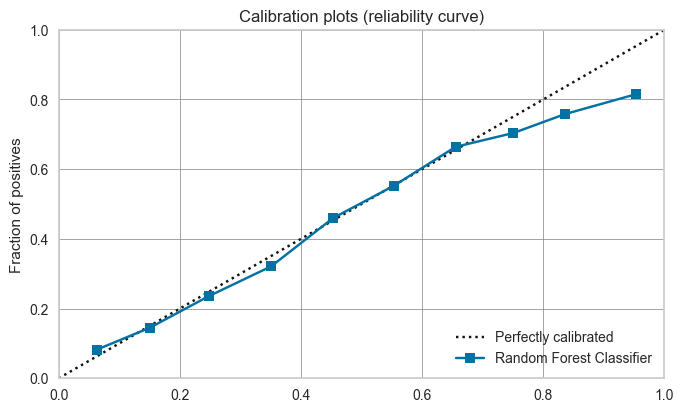

In [29]:
plot_model(rf, plot='calibration')

In [30]:
calibrated_rf = calibrate_model(rf)
# 35s

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8095,0.7722,0.3066,0.6331,0.4131,0.3155,0.3451
1,0.8340,0.7639,0.3926,0.7211,0.5083,0.4187,0.4468
2,0.8195,0.7728,0.3095,0.6968,0.4286,0.3398,0.3794
3,0.8258,0.7652,0.3639,0.6940,0.4774,0.3849,0.4138
4,0.8183,0.7720,0.3324,0.6705,0.4444,0.3503,0.3812
5,0.8283,0.7764,0.3610,0.7119,0.4791,0.3892,0.4214
6,0.8195,0.7695,0.3352,0.6763,0.4483,0.3548,0.3860
7,0.8233,0.7488,0.3266,0.7081,0.4471,0.3585,0.3966
8,0.8108,0.7481,0.3209,0.6328,0.4259,0.3268,0.3538


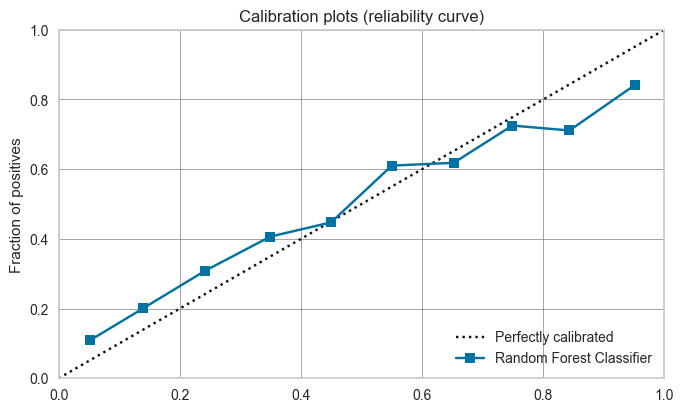

In [31]:
plot_model(calibrated_rf, plot='calibration')

Notice how different the above 2 plots look. One is before calibration and one is after. A perfectly calibrated classifier will follow the black dotted line in the above plots. Not only is `calibrated_rf` better calibrated but the `AUC` has also improved from `0.7591` to `0.7646`. By default, `calibrate_model()` uses the `sigmoid` method which corresponds to Platt's approach. The other available method is `isotonic` which is a non-parametric approach. See an example of calibration using the `isotonic` method below:

上の2つのプロットがいかに異なって見えるかに注目してください。1つは校正前、もう1つは校正後です。完全に調整された分類器は、上のプロットの黒い点線に従うことになります。`calibrated_rf` はより良くキャリブレーションされているだけでなく、 `AUC` も `0.7591` から `0.7646` へと向上しています。デフォルトでは、 `calibrate_model()` は Platt のアプローチに相当する `sigmoid` メソッドを使用します。その他の方法として、ノンパラメトリックな手法である `isotonic` も利用可能です。以下に、 `isotonic` メソッドを用いたキャリブレーションの例を示します。

In [32]:
calibrated_rf_isotonic = calibrate_model(rf, method='isotonic')
# 50s

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8095,0.7717,0.3095,0.6316,0.4154,0.3172,0.3460
1,0.8333,0.7639,0.4040,0.7085,0.5146,0.4230,0.4473
2,0.8214,0.7731,0.3209,0.7000,0.4401,0.3508,0.3887
3,0.8246,0.7651,0.3696,0.6825,0.4796,0.3851,0.4113
4,0.8202,0.7743,0.3467,0.6722,0.4575,0.3626,0.3912
5,0.8289,0.7773,0.3754,0.7043,0.4897,0.3982,0.4267
6,0.8202,0.7683,0.3410,0.6761,0.4533,0.3594,0.3896
7,0.8227,0.7509,0.3467,0.6875,0.4610,0.3683,0.3993
8,0.8127,0.7458,0.3496,0.6289,0.4494,0.3474,0.3692


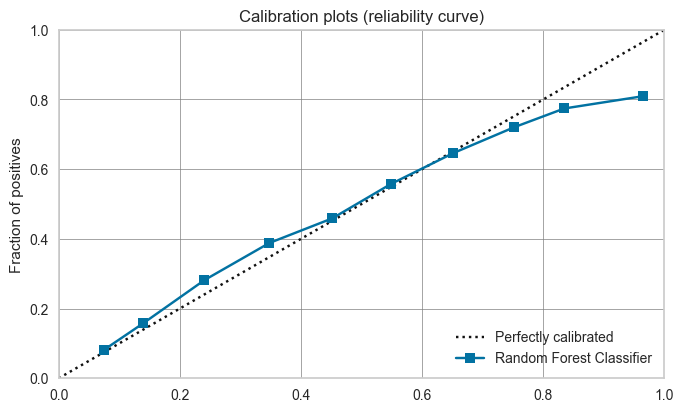

In [33]:
plot_model(calibrated_rf_isotonic, plot='calibration')

### 11.0 Experiment Logging

PyCaret >= 2.0 embeds MLflow Tracking component as a backend API and UI for logging parameters, code versions, metrics, and output files when running your machine learning code and for later visualizing the results. To log your experiments in pycaret simply use `log_experiment` and `experiment_name` parameter in the `setup` function, as we did in this example.

You can start the UI on `https://localhost:5000`. Simply initiate the MLFlow server from command line or from notebook. See example below:

### 11.0 実験のロギング

PyCaret >= 2.0 は MLflow Tracking コンポーネントをバックエンド API と UI として組み込み、機械学習コードを実行する際にパラメータ、コードバージョン、メトリクス、出力ファイルを記録し、後で結果を可視化するようにしました。PyCaretで実験を記録するには、この例で行ったように `setup` 関数で `log_experiment` と `experiment_name` パラメータを使用するだけです。

UIは`https://localhost:5000`で起動できます。コマンドラインやノートブックからMLFlowサーバを起動します。以下の例を参照してください。

In [34]:
# to start the MLFlow server from notebook:
# ノートブックから MLFlow サーバーを起動するには:
!mlflow ui

[2022-11-06 05:24:46 +0900] [24847] [INFO] Starting gunicorn 20.1.0
[2022-11-06 05:24:46 +0900] [24847] [INFO] Listening at: http://127.0.0.1:5000 (24847)
[2022-11-06 05:24:46 +0900] [24847] [INFO] Using worker: sync
[2022-11-06 05:24:46 +0900] [24849] [INFO] Booting worker with pid: 24849
^C
[2022-11-06 05:28:19 +0900] [24847] [INFO] Handling signal: int
[2022-11-06 05:28:19 +0900] [24849] [INFO] Worker exiting (pid: 24849)


### 12.0 Wrap-up / Next Steps?

We have covered a lot of new concepts in this tutorial. Most importantly we have seen how to use exploratory data analysis to customize a pipeline in `setup()` which has improved the results considerably when compared to what we saw earlier in [Binary Classification Tutorial (CLF101) - Level Beginner](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb). We have also learned how to perform and tune ensembling in PyCaret.

There are however a few more advanced things to cover in `pycaret.classification` which include defining and optimizing custom cost functions, interpreting more complex tree based models using shapley values, advanced ensembling techniques such as multiple layer stacknet and more pre-processing pipeline methods. We will cover all of this in our next and final tutorial in the `pycaret.classification` series.

See you at the next tutorial. Follow the link to [Binary Classification Tutorial (CLF103) - Level Expert](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Expert%20-%20CLF103.ipynb)

### 2.0 まとめ／次のステップは？

このチュートリアルでは、多くの新しい概念をカバーしました。最も重要なのは、探索的データ解析を使って `setup()` でパイプラインをカスタマイズする方法を見たことで、以前に見た [Binary Classification Tutorial (CLF101) - Level Beginner](https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Beginner%20-%20%20CLF101.ipynb) と比べてかなり結果が改善されました。また、PyCaretでアンサンブルを実行し、調整する方法を学びました。

ただし、`pycaret.classification` には、カスタムコスト関数の定義と最適化など、より高度な内容も含まれています。shapley 値用いたより複雑な木ベースモデルの解釈、複数レイヤー スタックネットなどの高度なアンサンブル手法、より多くの前処理パイプラインメソッドなどです。次回の `pycaret.classification` シリーズの最終チュートリアルでは、これらの全てをカバーする予定です。

それでは、次回のチュートリアルでお会いしましょう。[バイナリ分類チュートリアル（CLF103）～Level Expert]((https://github.com/pycaret/pycaret/blob/master/tutorials/Binary%20Classification%20Tutorial%20Level%20Expert%20-%20CLF103.ipynb))へのリンクはこちらです。